In [16]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [17]:
import os
import pickle
import pprint
from glob import glob
os.chdir('/home/users/alexno/sleep-staging')

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from h5py import File

from utils.plotting import plot_psg_hypnogram_hypnodensity
from utils.plotting import plot_hypnodensity

In [18]:
df = pd.read_csv('overview_file_cohortsEM-ling1.csv')
available_predictions = glob("experiments/**/SSC-WSC_test_predictions.pkl", recursive=True)
pprint.pprint(available_predictions)

['experiments/massc/avg_kw21_rnn128/20201209_025443/SSC-WSC_test_predictions.pkl',
 'experiments/massc/att30/20201124_080609/SSC-WSC_test_predictions.pkl',
 'experiments/massc/avg_kw21_rnn128_cyclic/20201212_150902/SSC-WSC_test_predictions.pkl',
 'experiments/massc/avg_kw21/20201126_043826/SSC-WSC_test_predictions.pkl']


In [19]:
selected_experiment = 'experiments/massc/avg_kw21/20201126_043826/SSC-WSC_test_predictions.pkl'
with open(selected_experiment, 'rb') as f:
    predictions = pickle.load(f)
list_studies = list(predictions.keys())
df_preds = pd.read_csv(os.path.join(os.path.dirname(selected_experiment), 'SSC-WSC_test_results.csv'), index_col=0)
df_preds = pd.merge(left=df_preds, right=df[['ID', 'Diagnosis', 'Label']], how='left', right_on='ID', left_on='SubjectID')
display(df_preds.query('Label == 0').sort_values('Balanced accuracy', ascending=False).head())

,FileID,SubjectID,Window,Case,Accuracy,Balanced accuracy,Kappa,F1,Precision,Recall,...,Precision - N3,Recall - N3,Support - N3,F1 - REM,Precision - REM,Recall - REM,Support - REM,ID,Diagnosis,Label
52,A1038_4 172720.h5,A1038_4 172720,1 s,all,0.849057,0.894873,0.795451,0.830931,0.806470,0.894873,...,0.548148,0.986667,75.0,0.985782,0.971963,1.000000,104.0,A1038_4 172720,'NON-NARCOLEPSY CONTROL',0
508,SSC_6856_1.h5,SSC_6856_1,1 s,all,0.876377,0.892037,0.811801,0.784684,0.733296,0.892037,...,0.480519,1.000000,37.0,0.880000,0.785714,1.000000,33.0,SSC_6856_1,'NON-NARCOLEPSY CONTROL',0
150,C1040_4 181859.h5,C1040_4 181859,1 s,all,0.883333,0.888253,0.817163,0.776490,0.769768,0.888253,...,0.842593,0.900990,101.0,0.973294,0.959064,0.987952,166.0,C1040_4 181859,'NON-NARCOLEPSY CONTROL',0
507,SSC_6854_1.h5,SSC_6854_1,1 s,all,0.831891,0.884168,0.776560,0.818131,0.812352,0.884168,...,0.847134,1.000000,133.0,0.921348,0.901099,0.942529,87.0,SSC_6854_1,'NON-NARCOLEPSY CONTROL',0
220,C9145_2 172540.h5,C9145_2 172540,1 s,all,0.840263,0.883908,0.773819,0.750679,0.725847,0.883908,...,0.407407,1.000000,55.0,0.945736,0.978610,0.915000,200.0,C9145_2 172540,'NON-NARCOLEPSY CONTROL',0


### All Narcolepsy Type 1

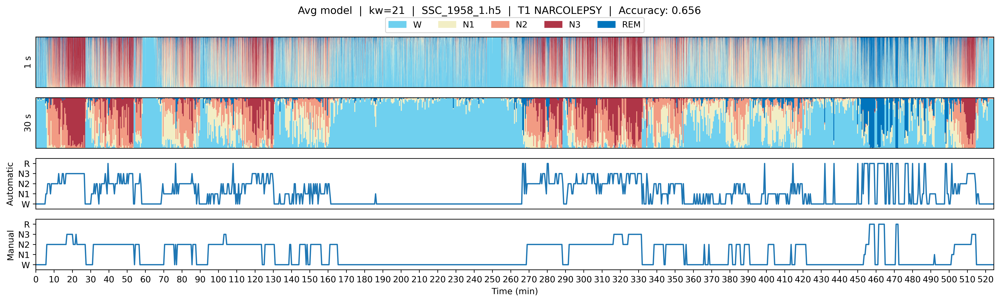

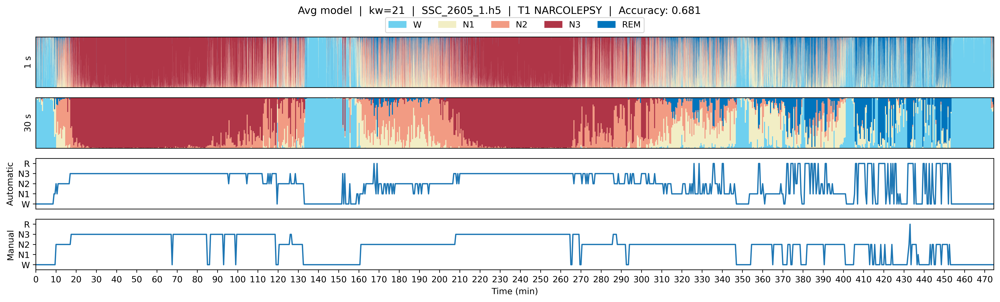

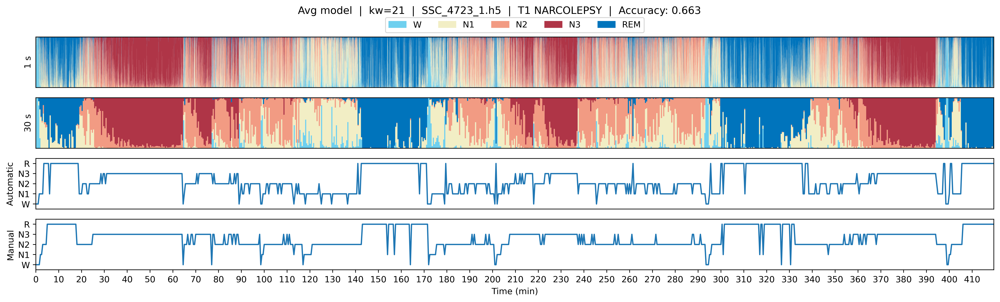

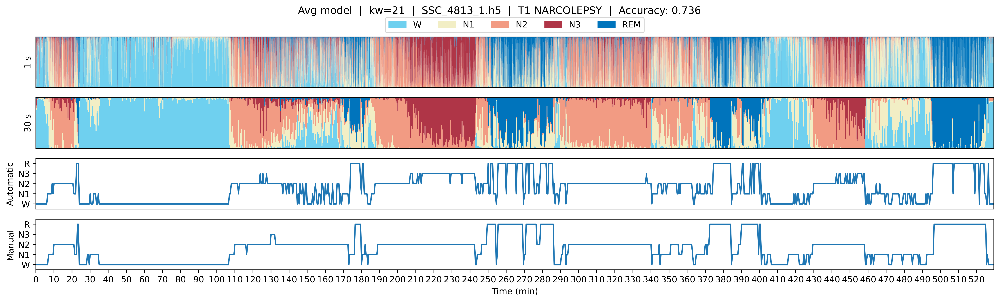

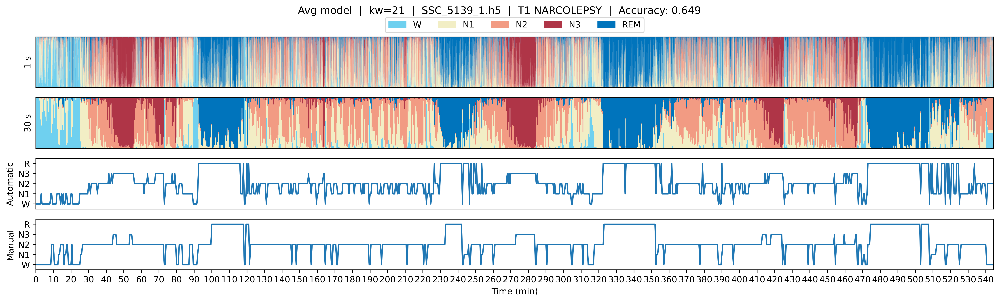

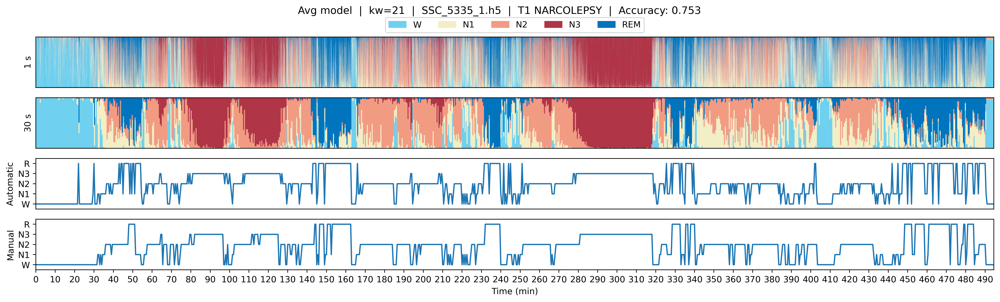

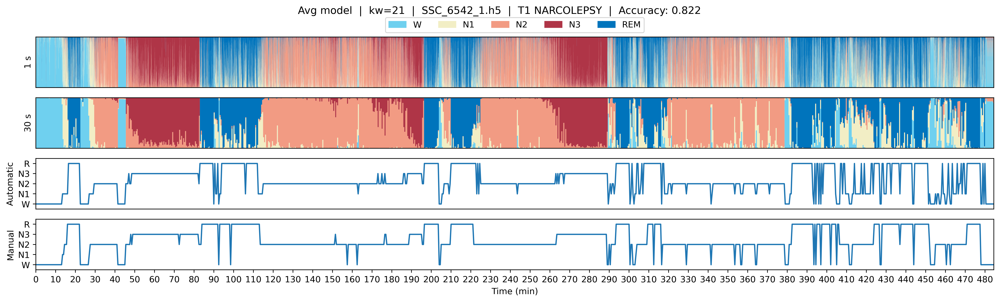

In [29]:
for idx, selected_record in df_preds.query('Label == 1').iterrows():
    fileid = selected_record['FileID']
    diagnosis = selected_record['Diagnosis'].replace("'", "")
    acc = selected_record['Accuracy']
    record = predictions[fileid]
    logits = record['logits']
    preds  = record['predicted']
    target = record['true']
    title = ("Avg model  |  " +
             "kw=21  |  " +
             f"{fileid}  |  " +
             f"{diagnosis}  |  " +
             f"Accuracy: {acc:.3f}")
    savepath = f"hypnodensities/massc-avg_kw21-20201126_043826/wholenight/narco_{fileid.split('.')[0]}.png"
    plot_hypnodensity(
        logits,
        preds,
        target,
        title=title,
        save_path=savepath
    )

### All other hypersomnias

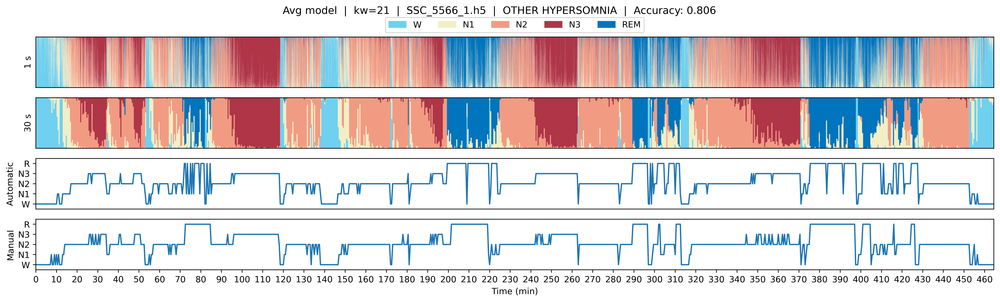

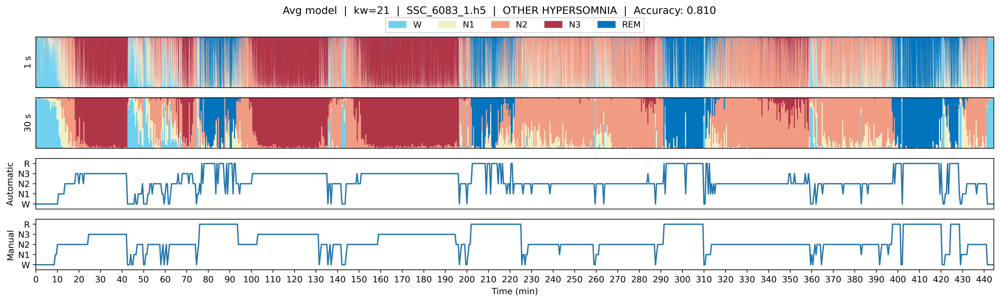

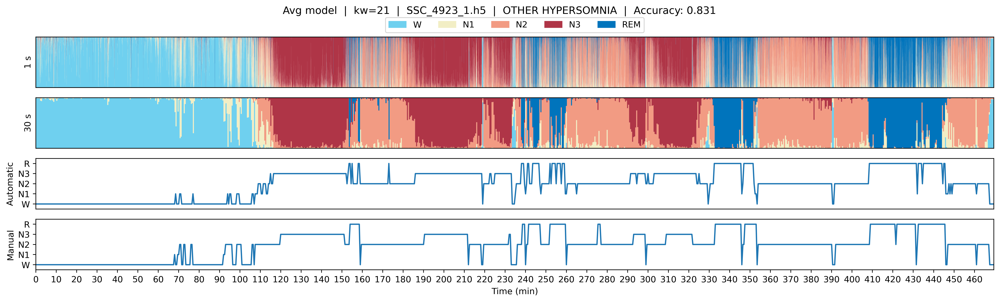

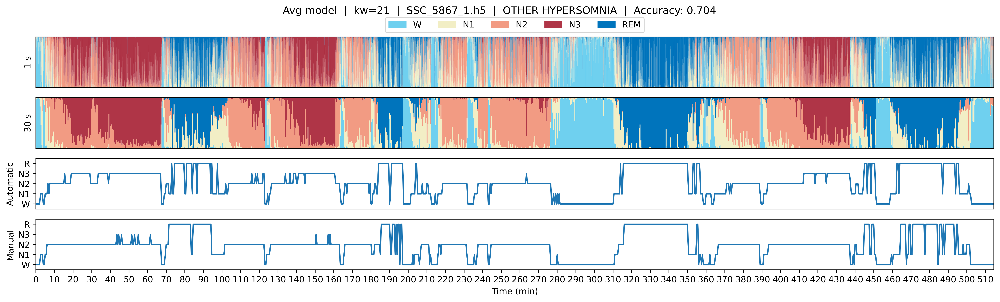

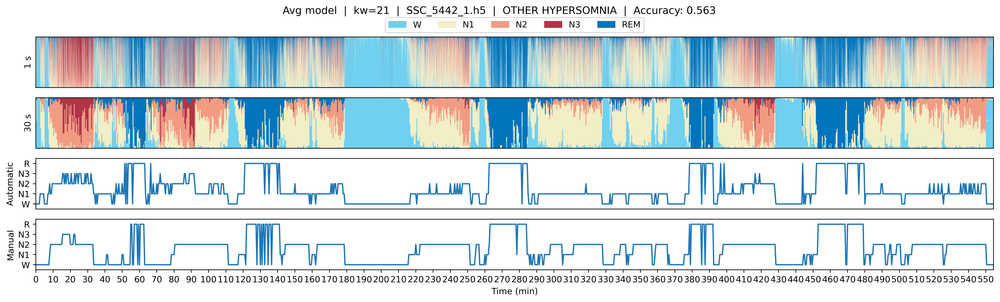

In [30]:
for idx, (_, selected_record) in enumerate(df_preds.loc[df_preds['Diagnosis'] == "'OTHER HYPERSOMNIA'"].sort_values(by='F1', ascending=False).iterrows()):
    fileid = selected_record['FileID']
    diagnosis = selected_record['Diagnosis'].replace("'", "")
    acc = selected_record['Accuracy']
    record = predictions[fileid]
    logits = record['logits']
    preds  = record['predicted']
    target = record['true']
    title = ("Avg model  |  " +
             "kw=21  |  " +
             f"{fileid}  |  " +
             f"{diagnosis}  |  " +
             f"Accuracy: {acc:.3f}")
    savepath = f"hypnodensities/massc-avg_kw21-20201126_043826/wholenight/hypersomnias_{fileid.split('.')[0]}.png"
    plot_hypnodensity(
        logits,
        preds,
        target,
        title=title,
        save_path=savepath
    )

### 10 best controls

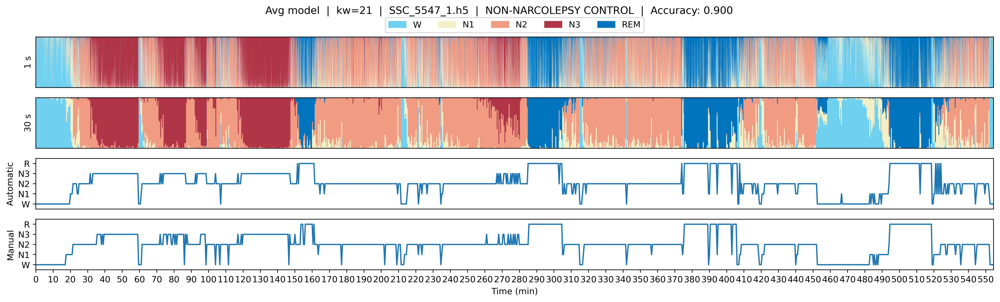

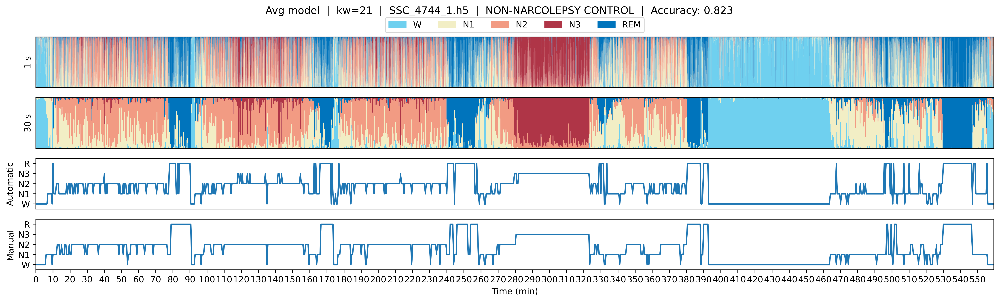

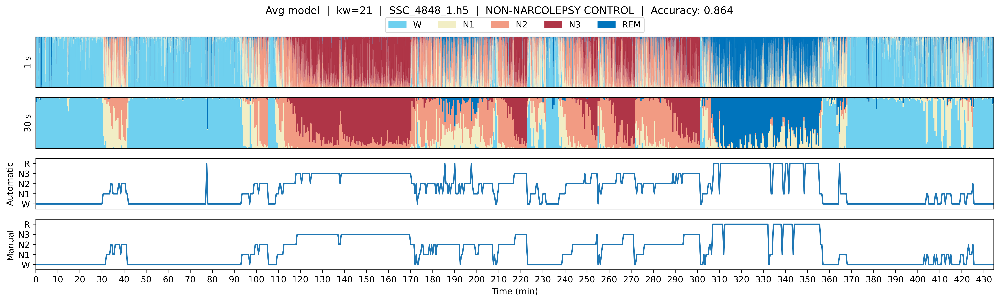

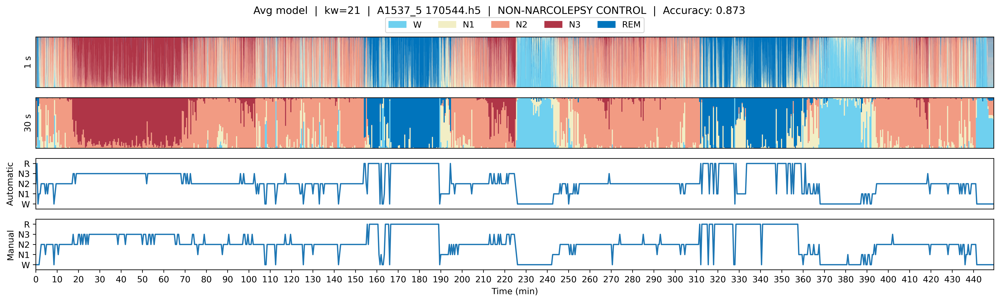

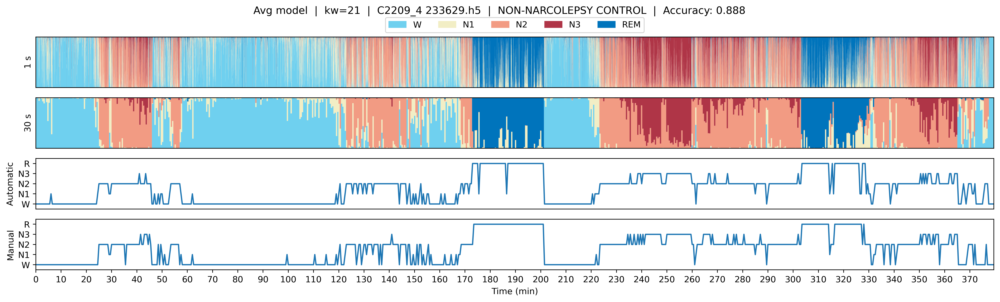

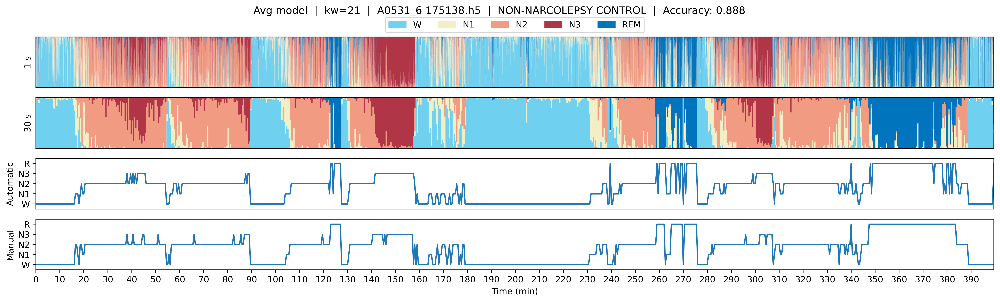

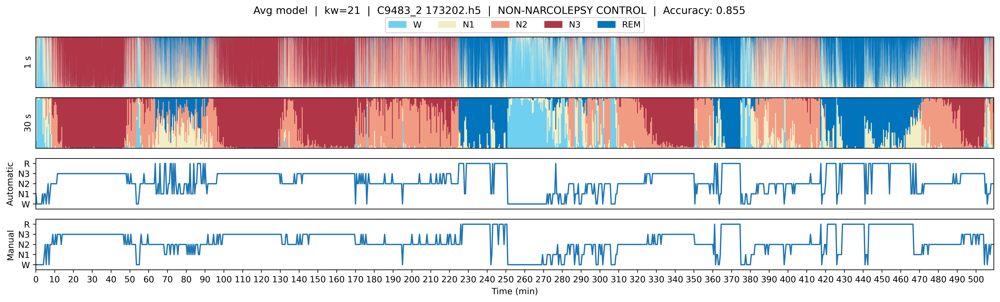

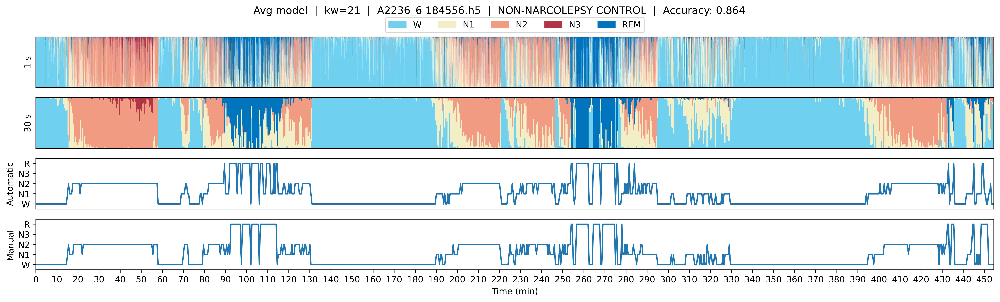

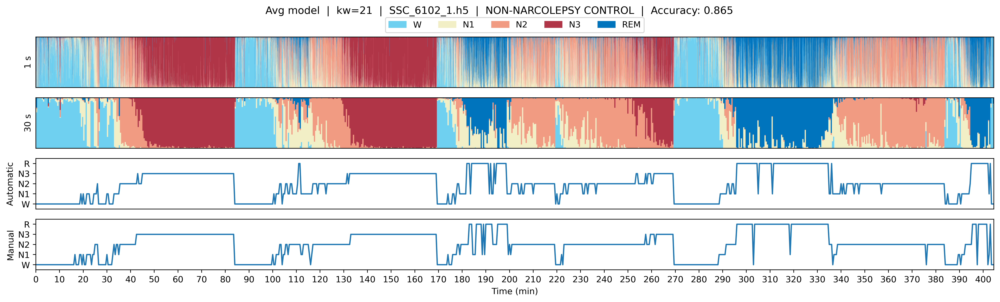

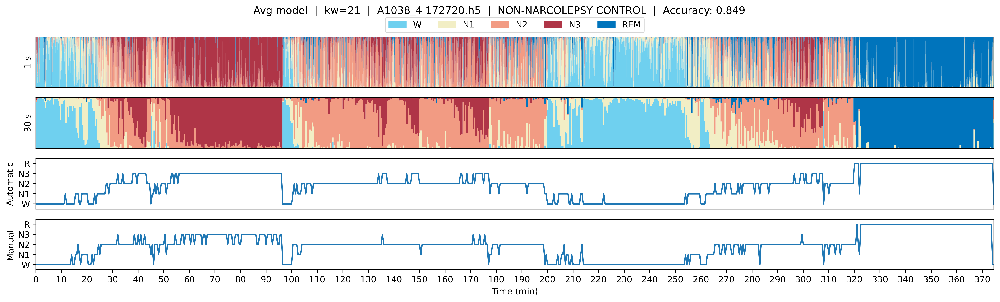

In [31]:
for idx, (_, selected_record) in enumerate(df_preds.loc[df_preds['Label'] == 0].sort_values(by='F1', ascending=False).iterrows()):
    if idx == 10:
        break
    fileid = selected_record['FileID']
    diagnosis = selected_record['Diagnosis'].replace("'", "")
    acc = selected_record['Accuracy']
    record = predictions[fileid]
    logits = record['logits']
    preds  = record['predicted']
    target = record['true']
    title = ("Avg model  |  " +
             "kw=21  |  " +
             f"{fileid}  |  " +
             f"{diagnosis}  |  " +
             f"Accuracy: {acc:.3f}")
    savepath = f"hypnodensities/massc-avg_kw21-20201126_043826/wholenight/control_{fileid.split('.')[0]}.png"
    plot_hypnodensity(
        logits,
        preds,
        target,
        title=title,
        save_path=savepath
    )

### 10 worst controls

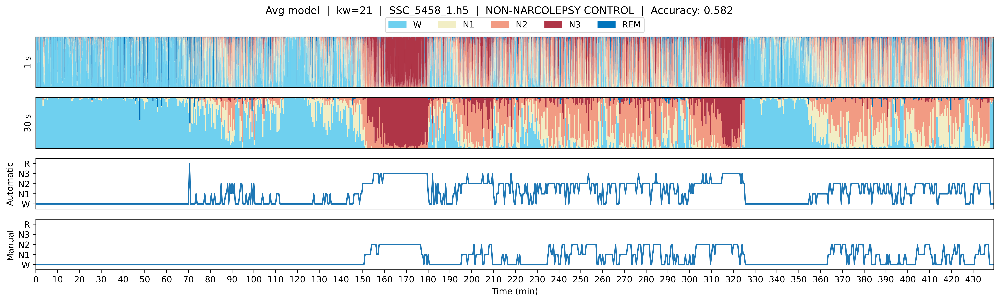

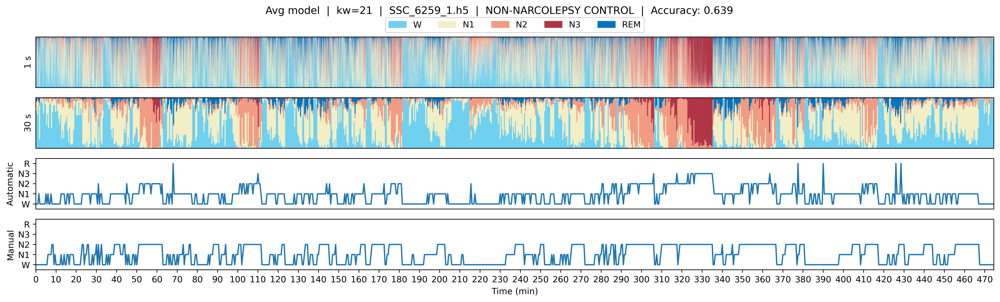

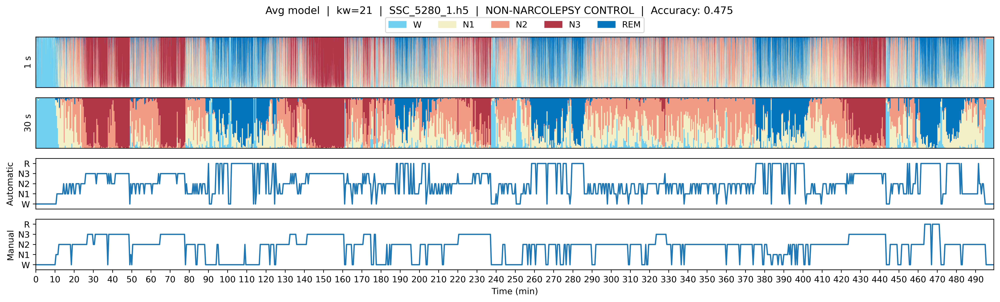

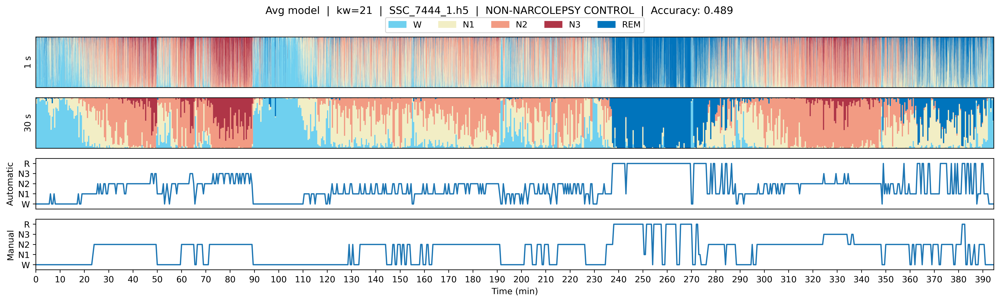

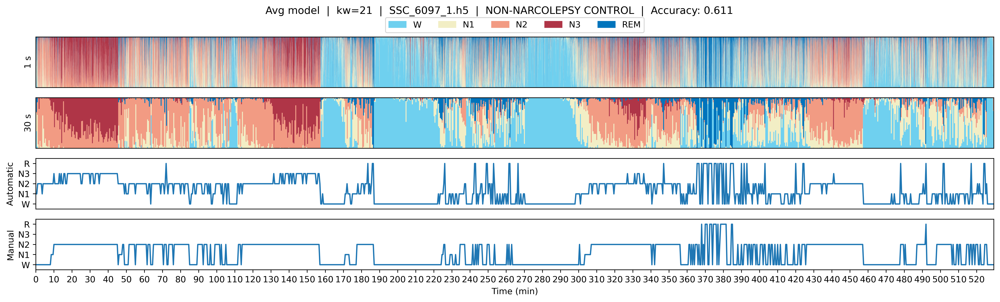

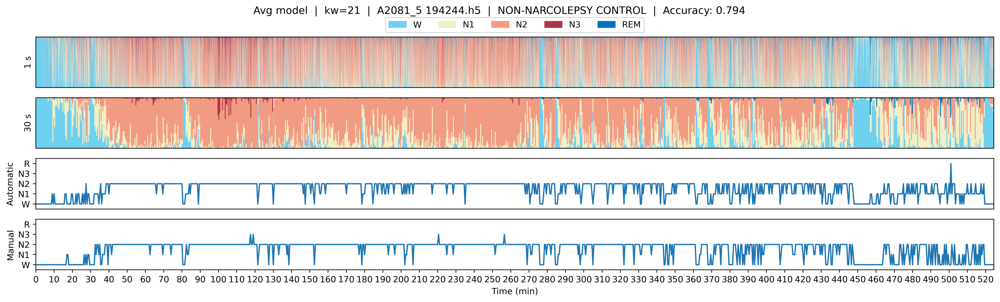

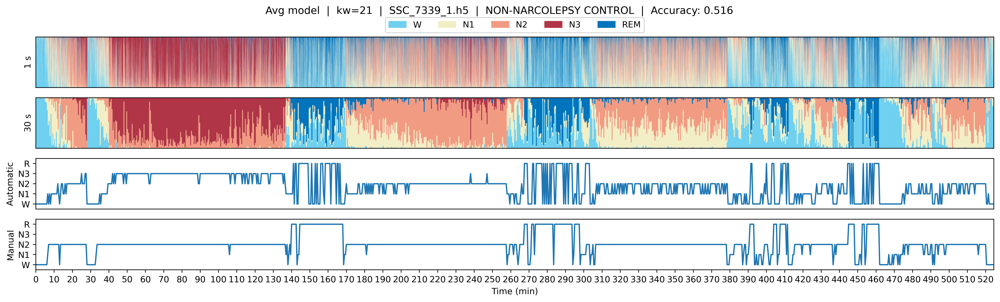

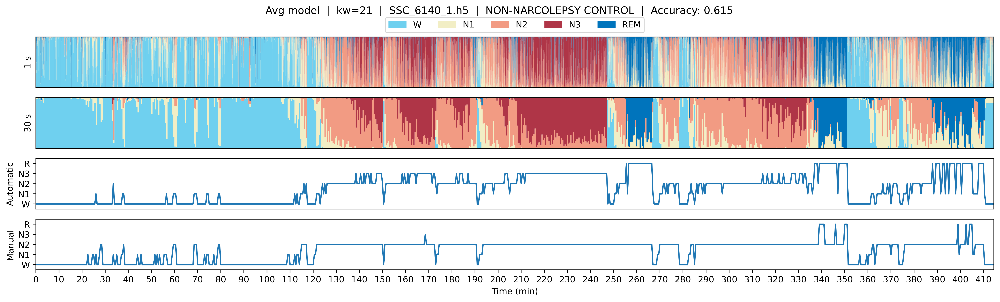

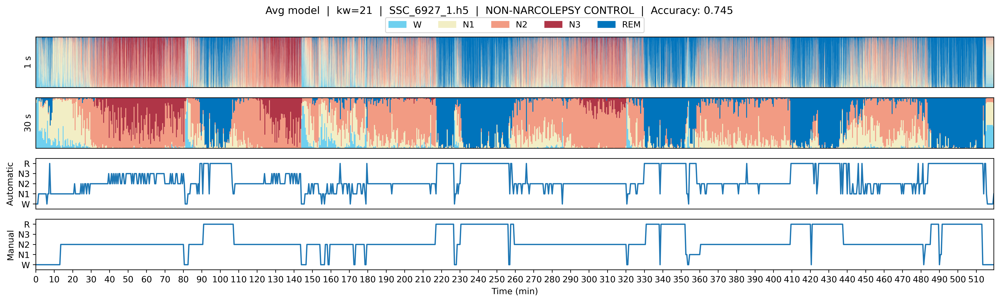

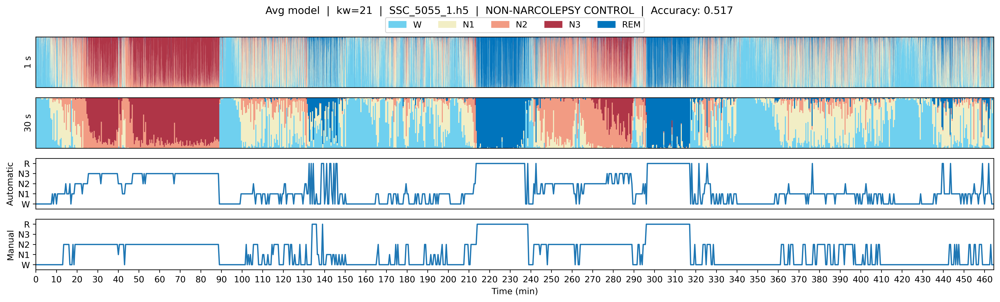

In [32]:
for idx, (_, selected_record) in enumerate(df_preds.loc[df_preds['Label'] == 0].sort_values(by='F1', ascending=True).iterrows()):
    if idx == 10:
        break
    fileid = selected_record['FileID']
    diagnosis = selected_record['Diagnosis'].replace("'", "")
    acc = selected_record['Accuracy']
    record = predictions[fileid]
    logits = record['logits']
    preds  = record['predicted']
    target = record['true']
    title = ("Avg model  |  " +
             "kw=21  |  " +
             f"{fileid}  |  " +
             f"{diagnosis}  |  " +
             f"Accuracy: {acc:.3f}")
    savepath = f"hypnodensities/massc-avg_kw21-20201126_043826/wholenight/control_{fileid.split('.')[0]}.png"
    plot_hypnodensity(
        logits,
        preds,
        target,
        title=title,
        save_path=savepath
    )

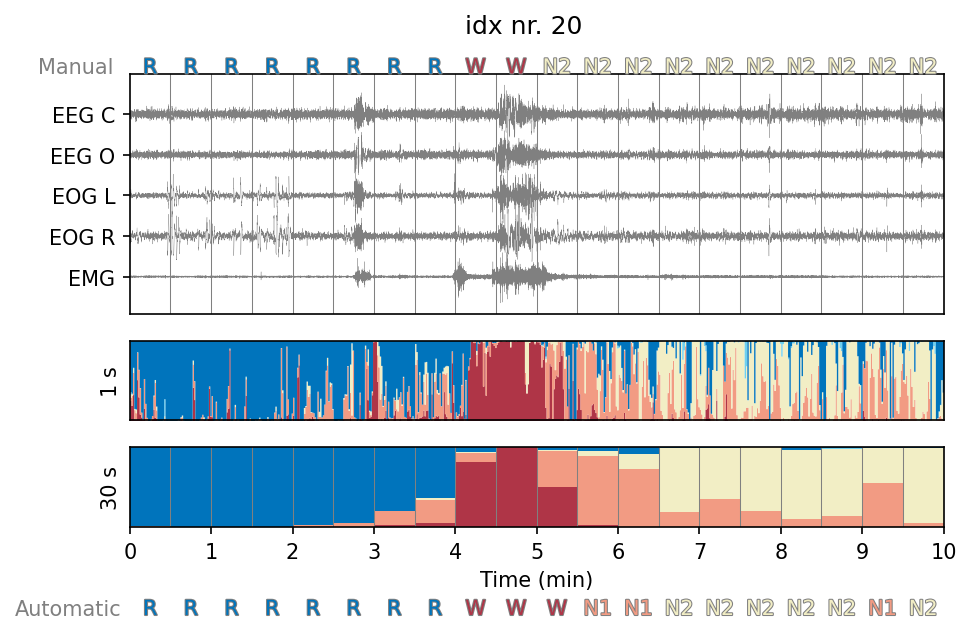

In [61]:
plot_psg_hypnogram_hypnodensity(
    selected_record, 
    record_predictions=record, 
    seq_idx=20,
    interval=10,
    save_path=f'{selected_record}-seq20.png'
)

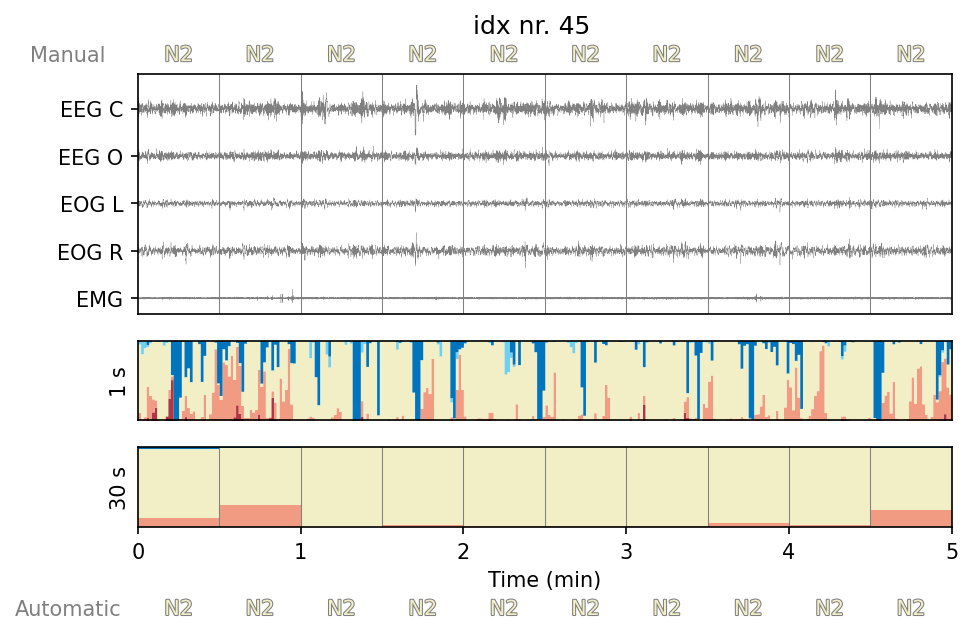

In [41]:
plot_psg_hypnogram_hypnodensity(
    selected_record, 
    record_predictions=record, 
    seq_idx=45,
    interval=5
)